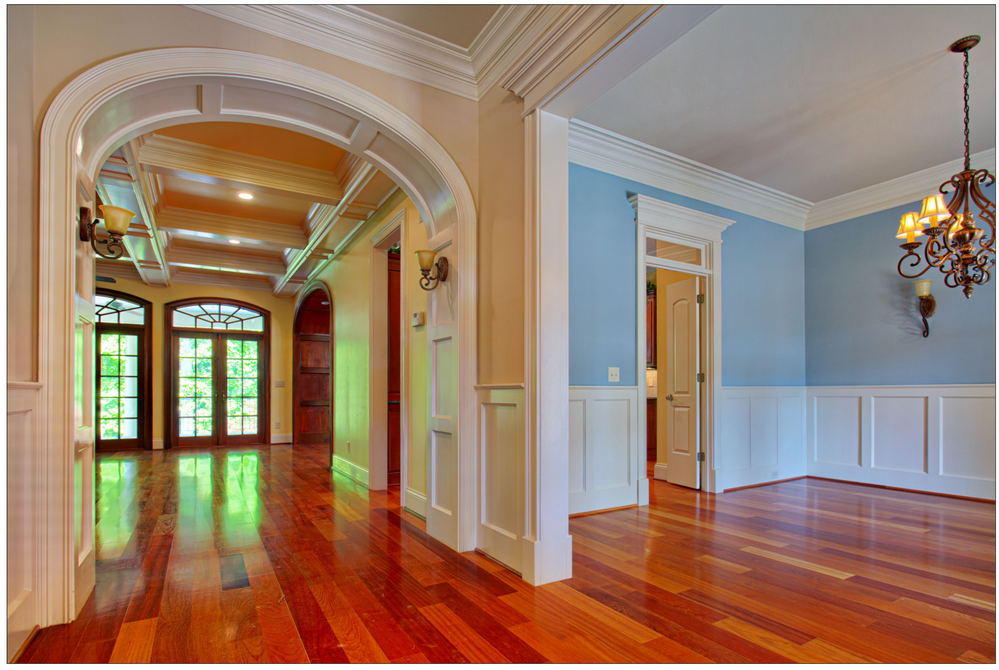

In [1]:
from imageio import imread
from matplotlib import pyplot as plt

# Load image
image = imread("../test/media/tca/1.jpg")

# Show
plt.figure(figsize=(30, 20))
plt.xticks([])
plt.yticks([])
plt.imshow(image, interpolation="bilinear")
plt.show()

- Divide image into patches
- In each patch, find cornerness centers

In [13]:
from cv2 import cornerHarris
from numpy import argpartition, array, column_stack, float32, ndarray, stack, unravel_index

def compute_roi (input: ndarray, region_count: int=8, corner_threshold: float=0.02) -> ndarray:
    """
    Compute chromatic aberration regions of interest.

    Parameters:
        image (ndarray): Input image with shape (H,W,3).
        region_count (int): Number of independent regions on each axis to evaluate.
        corner_threshold (float): Minimum cornerness for pixel to be considered ROI, in range [0., 1.].
    """
    # Compute cornerness over entire image
    corner_map = cornerHarris(input[...,1].astype(float32), 2, 3, 0.04)
    corner_threshold = corner_map.max() * corner_threshold
    # Evaluate regions
    height, width, _ = input.shape
    patch_size = array([width, height]) // region_count
    CORNER_COUNT = 1 # Number of corners to extract per region
    roi = []
    for j in range(region_count):
        for i in range(region_count):
            # Extract region
            min = array([i * patch_size[0], j * patch_size[1]])
            max = min + patch_size
            region = input[min[1]:max[1],min[0]:max[0],1]
            # Find corners
            corner_map = cornerHarris(region.astype(float32), 2, 3, 0.04)
            corner_indices = argpartition(corner_map, -CORNER_COUNT, axis=None)[-CORNER_COUNT:]
            y_coords, x_coords = unravel_index(corner_indices, corner_map.shape)
            coords = column_stack([x_coords, y_coords])
            # Threshold
            for coord in coords: # CHECK # Need to vectorize this
                x, y = coord
                if corner_map[y, x] > corner_threshold:
                    roi.append(coord + min)
    roi = stack(roi)
    return roi

In [14]:
# Compute roi
coords = compute_roi(image, region_count=8, corner_threshold=0.05)
coords.shape

(28, 2)

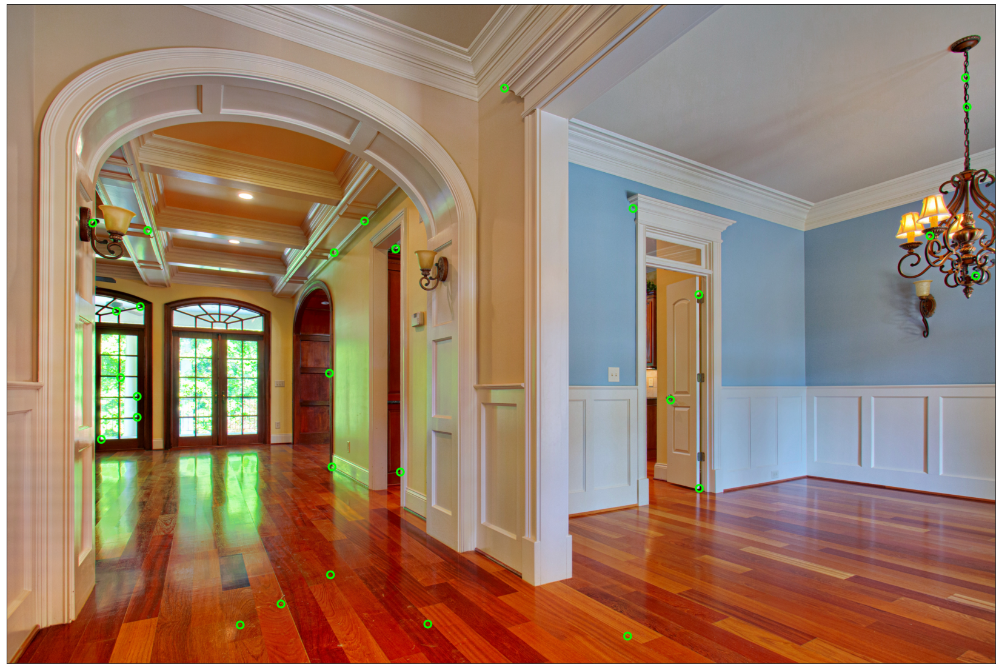

In [16]:
from cv2 import circle

# Draw
corner_image = image.copy()
for coord in coords:
    x, y = coord
    circle(corner_image, (x, y), 20, (0,255,0), 10)

# Show
plt.figure(figsize=(30, 20))
plt.xticks([])
plt.yticks([])
plt.imshow(corner_image, interpolation="bilinear")
plt.show()

In [17]:
from numpy import concatenate
from typing import Tuple

def extract_patches (input: ndarray, centers: ndarray, size: float=0.1) -> Tuple[ndarray, ndarray]:
    """
    Extract image patches centered around a set of coordinates.
    
    Note that the number of returned patches might be less than N, as patches that are not full-size are discarded.

    Parameters:
        input (ndarray): Input image with shape (H,W,3).
        centers (ndarray): Patch center (x,y) coordinates with shape (N,2).
        size (float): Relative patch size in range [0., 1.].

    Returns:
        tuple: Patch stack with shape (M,S,S,3) and patch centers with shape (M,2).
    """
    height, width, _ = input.shape
    size = int(min(width, height) * size)
    negatives = centers - size // 2
    patches = [input[y_min:y_max, x_min:x_max] for x_min, y_min, x_max, y_max in concatenate([negatives, negatives + size], axis=1)]
    patches = [(patch, center) for patch, center in zip(patches, centers) if patch.shape[0] == patch.shape[1] == size]
    patches, centers = zip(*patches)
    patches, centers = stack(patches), stack(centers)
    return patches, centers

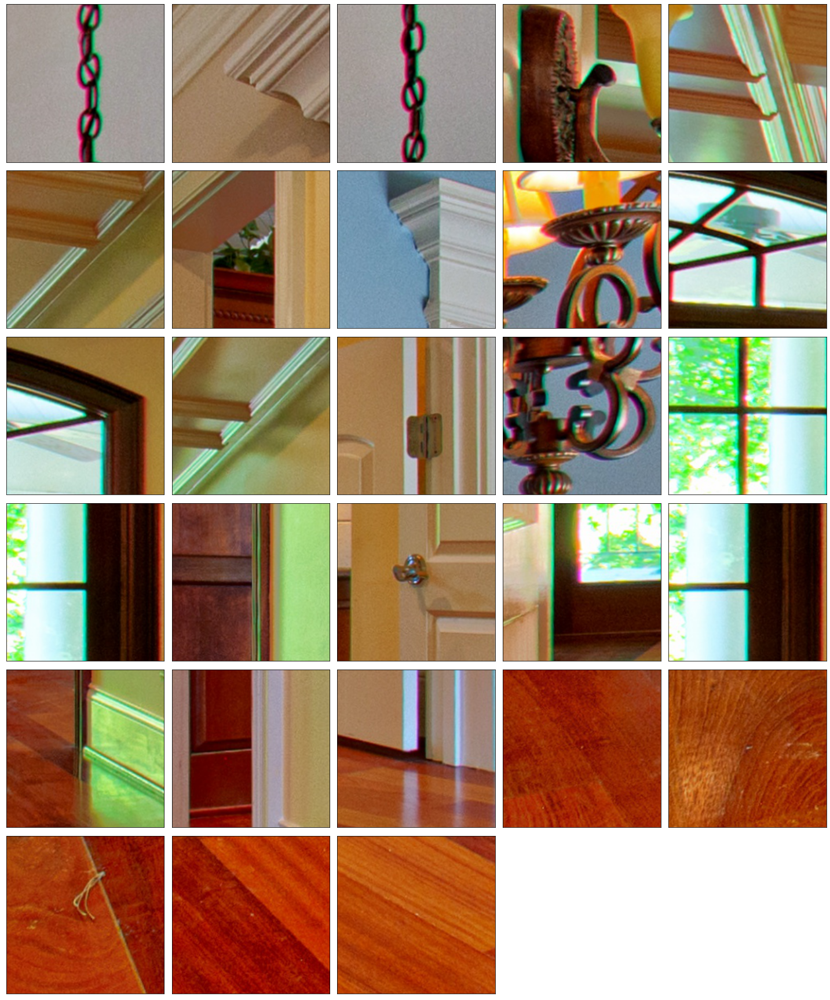

In [22]:
# Extract patches
patches, centers = extract_patches(image, coords, 0.05)

# Display
plt.figure(figsize=(20, 28))
plt.tight_layout()
for i, patch in enumerate(patches):
    plt.subplot(7, 5, i+1)
    plt.xticks([])
    plt.yticks([])
    plt.imshow(patch, interpolation="bilinear")
plt.tight_layout()
plt.show()

In [35]:
from cv2 import findTransformECC, MOTION_TRANSLATION, TERM_CRITERIA_COUNT, TERM_CRITERIA_EPS
from numpy import eye, ones, split

def compute_patch_displacements (patches: ndarray) -> Tuple[ndarray, ndarray]:
    """
    Compute per-patch alignment displacements for N patches.

    Note that the number of returned displacements might be less than N, when no suitable displacement can be computed for some patches.

    Parameters:
        patches (ndarray): Patch stack with shape (N,S,S,3).

    Returns:
        tuple: Red and blue channel displacement vectors with shape (M,2,2), selection mask with shape (N,).
    """
    # Constants
    IDENTITY = eye(2, 3, dtype=float32)
    CRITERIA = (TERM_CRITERIA_EPS | TERM_CRITERIA_COUNT, 50, 1e-4)
    # Compute
    displacements = []
    mask = ones(patches.shape[0]).astype(bool)
    for i, patch in enumerate(patches):
        try:
            patch_r, patch_g, patch_b = split(patch, 3, axis=2)
            _, warp_matrix_r = findTransformECC(patch_g, patch_r, IDENTITY.copy(), MOTION_TRANSLATION, CRITERIA, None, 5)
            _, warp_matrix_b = findTransformECC(patch_g, patch_b, IDENTITY.copy(), MOTION_TRANSLATION, CRITERIA, None, 5)
            displacement = stack((warp_matrix_r[:,2], warp_matrix_b[:,2]), axis=0)
            displacements.append(displacement)
        except:
            mask[i] = False
    # Return
    displacements = stack(displacements)
    return displacements, mask

In [20]:
from cv2 import warpAffine, INTER_LINEAR, WARP_INVERSE_MAP

def displace_patches (patches: ndarray, displacements: ndarray) -> ndarray:
    """
    Displace patches given a set of red-blue channel displacement vectors.

    Parameters:
        patches (ndarray): Patch stack with shape (N,S,S,3).
        displacements (ndarray): Red-blue channel displacement vectors with shape (N,2,2).

    Returns:
        Displaced patch stack with shape (N,S,S,3).
    """
    result = []
    height, width = patches.shape[1:3]
    for patch, displacement in zip(patches, displacements):
        patch_r, patch_g, patch_b = split(patch, 3, axis=2)
        transform_r, transform_b = eye(2, 3, dtype=float32), eye(2, 3, dtype=float32)
        transform_r[:,2], transform_b[:,2] = displacement
        patch_r = warpAffine(patch_r, transform_r, (width, height), flags=INTER_LINEAR + WARP_INVERSE_MAP)
        patch_g = patch_g.squeeze()
        patch_b = warpAffine(patch_b, transform_b, (width, height), flags=INTER_LINEAR + WARP_INVERSE_MAP)
        patch = stack((patch_r, patch_g, patch_b), axis=2)
        result.append(patch)
    result = stack(result)
    return result

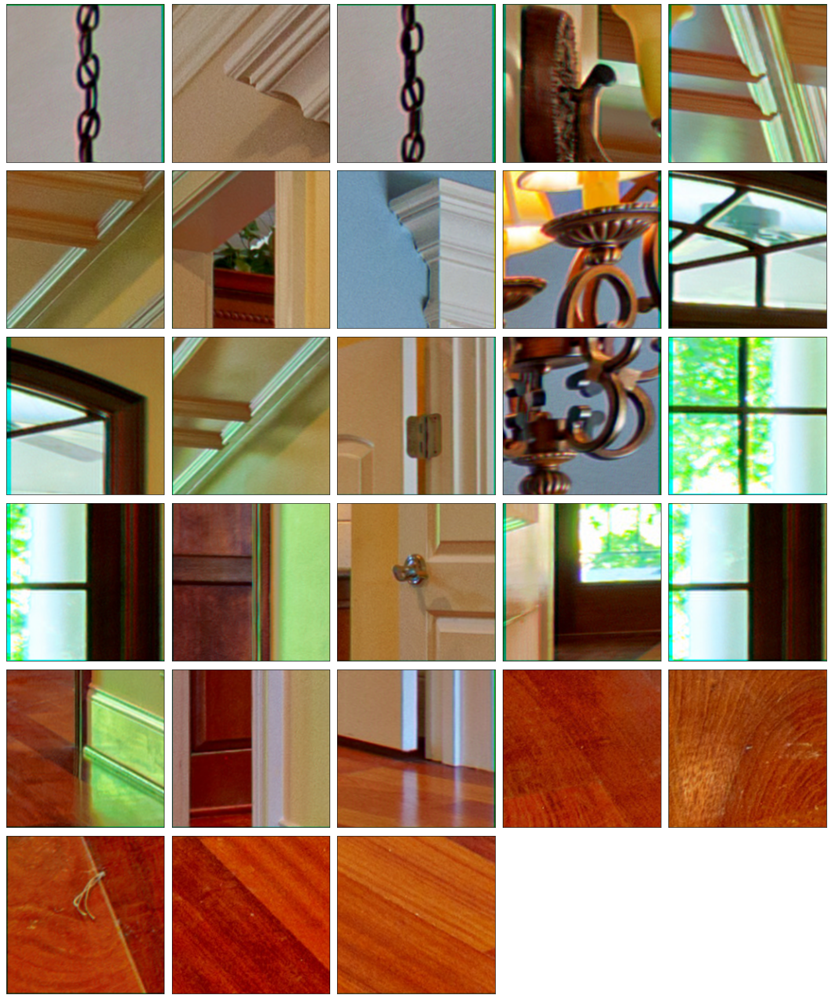

In [36]:
# Compute displacements
displacements, mask = compute_patch_displacements(patches)

# Displace patches
aligned_patches = displace_patches(patches[mask], displacements)

# Display
plt.figure(figsize=(20, 28))
for i, patch in enumerate(aligned_patches):
    plt.subplot(7, 5, i+1)
    plt.xticks([])
    plt.yticks([])
    plt.imshow(patch, interpolation="bilinear")
plt.tight_layout()
plt.show()

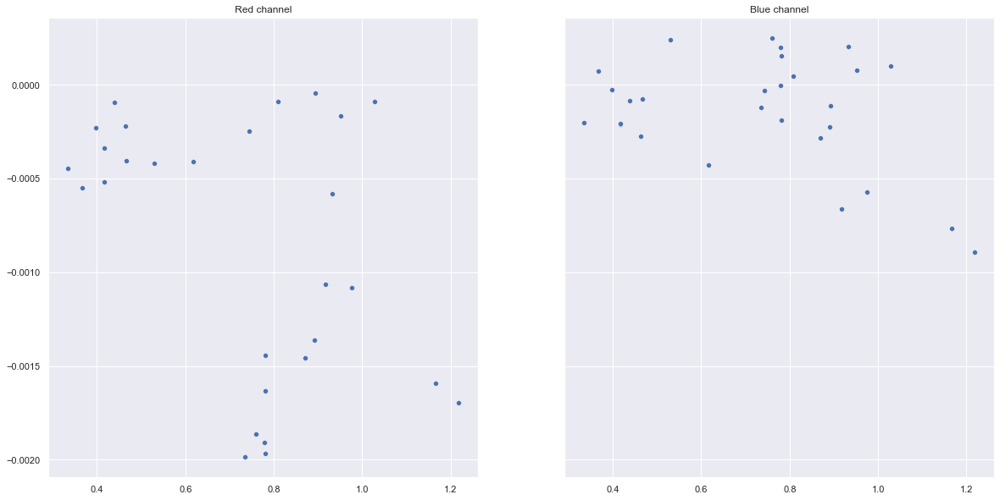

In [37]:
from numpy import array
from numpy.linalg import norm
import seaborn as sns

# Compute radii
image_size = array([ image.shape[1], image.shape[0] ])
image_center = image_size / 2.
radius_field = norm((centers[mask] - image_center) / image_center, axis=1)
offset_radii_r = norm((centers[mask] - displacements[:,0] - image_center) / image_center, axis=1)
offset_radii_b = norm((centers[mask] - displacements[:,1] - image_center) / image_center, axis=1)
displaced_radii_r = offset_radii_r - radius_field
displaced_radii_b = offset_radii_b - radius_field

# Plot
sns.set()
fig, (ax1, ax2) = plt.subplots(1, 2, sharey=True, figsize=(20, 10))
sns.scatterplot(x=radius_field, y=displaced_radii_r, ax=ax1)
sns.scatterplot(x=radius_field, y=displaced_radii_b, ax=ax2)
ax1.set_title("Red channel")
ax2.set_title("Blue channel")
plt.show()

In [49]:
from sklearn.linear_model import LinearRegression, RANSACRegressor

X = stack([radius_field, radius_field ** 2, radius_field ** 3, radius_field ** 4][:red_coeffs.shape[0]], axis=1)
y_r = norm((centers[mask] + displacements[:,0] - image_center) / image_center, axis=1)
y_b = norm((centers[mask] + displacements[:,1] - image_center) / image_center, axis=1)

regressor_r = RANSACRegressor(base_estimator=LinearRegression(fit_intercept=False))
regressor_r.fit(X, y_r)

regressor_b = RANSACRegressor(base_estimator=LinearRegression(fit_intercept=False))
regressor_b.fit(X, y_b)

red_coeffs = regressor_r.estimator_.coef_
blue_coeffs = regressor_b.estimator_.coef_

print("Red:", red_coeffs)
print("Blue:", blue_coeffs)

Red: [ 1.00073665e+00  1.36633751e-03 -9.41956503e-04]
Blue: [ 1.00145707 -0.00399326  0.00278585]


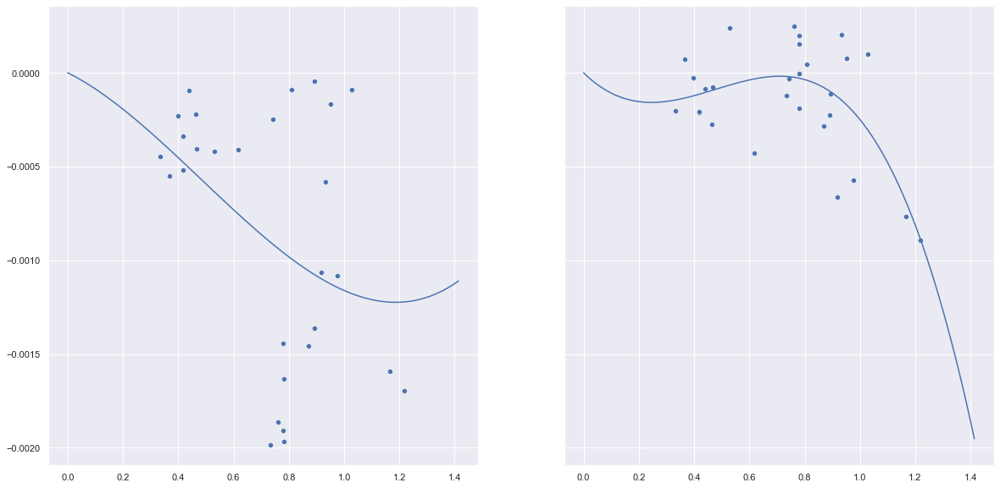

In [50]:
from numpy import linspace

test_r = linspace(0., 1.414, 100)
test_r_2 = test_r ** 2
test_r_3 = test_r ** 3
test_r_4 = test_r ** 4

R = stack([test_r, test_r_2, test_r_3, test_r_4][:red_coeffs.shape[0]], axis=1)
test_y_r = regressor_r.predict(R)
test_y_b = regressor_b.predict(R)

fig, (ax1, ax2) = plt.subplots(1, 2, sharey=True, figsize=(20, 10))
sns.scatterplot(x=radius_field, y=displaced_radii_r, ax=ax1)
sns.scatterplot(x=radius_field, y=displaced_radii_b, ax=ax2)
sns.lineplot(test_r, -(test_y_r - test_r), ax=ax1)
sns.lineplot(test_r, -(test_y_b - test_r), ax=ax2)
plt.show()

In [57]:
from cv2 import remap, INTER_LANCZOS4
from imageio import imwrite
from numpy import float32, linspace, meshgrid

height, width, _ = image.shape
wg, hg = meshgrid(linspace(-1., 1., width), linspace(-1., 1., height))

sample_field = stack([wg, hg], axis=2)
rad_field = norm(sample_field, axis=2)
rad_fields = [rad_field ** i for i in range(4)]

rad_field_r = stack([coeff * field for coeff, field in zip(red_coeffs, rad_fields)], axis=0).sum(axis=0)
rad_field_b = stack([coeff * field for coeff, field in zip(blue_coeffs, rad_fields)], axis=0).sum(axis=0)

sample_field_r = (sample_field * rad_field_r[...,None])
sample_field_b = (sample_field * rad_field_b[...,None])

sample_field_r = (sample_field_r + array([ 1., 1. ])) / 2.
sample_field_b = (sample_field_b + array([ 1., 1. ])) / 2.
sample_field_r = sample_field_r * image_size
sample_field_b = sample_field_b * image_size

sample_field_r = sample_field_r.astype(float32)
sample_field_b = sample_field_b.astype(float32)

image_r, image_g, image_b = split(image, 3, axis=2)
image_r = remap(image_r, sample_field_r, None, INTER_LANCZOS4)
image_g = image_g.squeeze()
image_b = remap(image_b, sample_field_b, None, INTER_LANCZOS4)

result = stack([image_r, image_g, image_b], axis=2)
imwrite("result.jpg", result)